In [67]:
#Load all packages

import numpy as np
import pandas as pd
from textblob import TextBlob
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.stats as stats
%matplotlib inline
import statsmodels.api as sm
import statsmodels.formula.api as smf
import missingno as msno
import re
from sklearn.compose import make_column_transformer

# Scaling
from sklearn.preprocessing import scale
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import PowerTransformer
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import RobustScaler

# Importing plotly and cufflinks in offline mode
import plotly.express as px
import cufflinks as cf
import plotly.offline
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)

# Ignore Warnings
import warnings
warnings.filterwarnings("ignore")
warnings.warn("this will not show")

# Figure&Display options
plt.rcParams["figure.figsize"] = (10,6)
pd.set_option('max_colwidth',200)
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 200)
pd.set_option('display.float_format', lambda x: '%.3f' % x)

import ipywidgets
from ipywidgets import interact

import nltk
from nltk.tokenize import sent_tokenize, word_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk.stem import PorterStemmer
from collections import Counter
from wordcloud import WordCloud
import colorama
from colorama import Fore, Style  # maakes strings colored
from termcolor import colored
import plotly.io as pio
pio.renderers.default = 'notebook'


In [68]:
# Read Data-set from csv file
df = pd.read_csv('Twitter Jan Mar.csv')

In [224]:
df.head()

,date,content,like_count,retweet_count,content_adj
0,2023-03-29 22:58:21+00:00,"Free AI marketing and automation tools, strategies, and collaboration launching new week https://t.co/Qwti8LfBpb #ChatGPT",0.000,0.000,free new
1,2023-03-29 22:58:18+00:00,@MecoleHardman4 Chat GPT says it’s 15. 😂,0.000,0.000,
2,2023-03-29 22:57:53+00:00,"https://t.co/FjJSprt0te - Chat with any PDF!\nCheck out how this new AI quickly answers questions from your PDFs.\nPerfect for students, researchers, and other curious minds. \n#research #chatpdf ...",0.000,0.000,new ai perfect curious
3,2023-03-29 22:57:52+00:00,"AI muses: ""In the court of life, we must all face the judge of destiny and the jury of our actions. ⚖️🔮 #OutOfContextAI #AILifeLessons #ChatGPT",0.000,0.000,ai destiny outofcontextai
4,2023-03-29 22:57:26+00:00,"Most people haven't heard of Chat GPT yet.\nFirst, elite factions will decide which way to go on AI safety. Next they will push their agenda(s) on the public with misleading and oversimplified med...",0.000,0.000,elite next public oversimplified red


In [70]:
# Check shape
df.shape

(500036, 6)

In [71]:
# LOOKING AT THE DATA SET
#ASSIGNING DIFFERENT KEY CHARACTERSTICS OF THE DATA SET AS DIFFERENT KEYWORDS




def first_looking(df):
    # SHAPE OF THE DATA SET
    print(colored("Shape:", attrs=['bold']), df.shape,'\n',
          colored('-'*79, 'red', attrs=['bold']),
          colored("\nInfo:\n", attrs=['bold']), sep='')
    print(df.info(), '\n',
          colored('-'*79, 'red', attrs=['bold']), sep='')
    # NUMBER OF UNIQUE VALUES IN THE DATASET
    print(colored("Number of Uniques:\n", attrs=['bold']), df.nunique(),'\n',
          colored('-'*79, 'red', attrs=['bold']), sep='')
    # # NUMBER OF MISSING VALUES IN THE DATASET
    print(colored("Missing Values:\n", attrs=['bold']), missing_values(df),'\n',
          colored('-'*79, 'red', attrs=['bold']), sep='')
    # LIST ALL THE COLOUMNS OF THE DATASET
    print(colored("All Columns:", attrs=['bold']), list(df.columns),'\n',
          colored('-'*79, 'red', attrs=['bold']), sep='')
    # REPLACE
    df.columns= df.columns.str.lower().str.replace('&', '_').str.replace(' ', '_')

    print(colored("Columns after rename:", attrs=['bold']), list(df.columns),'\n',
              colored('-'*79, 'red', attrs=['bold']), sep='')

    
def missing_values(df):
    # ARRANGE MISSING VALUES IN A
    missing_number = df.isnull().sum().sort_values(ascending=False)
    missing_percent = (df.isnull().sum()/df.isnull().count()).sort_values(ascending=False)  # count() only counts the non-NA values, therefore we first use isnull to include all the values (false and true), then count()
    #print(pd.concat([missing_number, missing_percent], axis=1, keys=['Missing_Number', 'Missing_Percent']))
    missing_values = pd.concat([missing_number, missing_percent], axis=1, keys=['Missing_Number', 'Missing_Percent'])
    return missing_values[missing_values['Missing_Number']>0]

def drop_columns(df, drop_columns):
    if drop_columns!=[]:
        df.drop(drop_columns, axis = 1, inplace = True)
        print(drop_columns, 'were dropped')
    else:
        print(colored('We will now check the missing values and if needed we will drop related columns!', attrs=['bold']),'\n',
              colored('-'*79, 'red', attrs=['bold']), sep='')

# TO CHECK FOR DUPLICATE VALUES.

def duplicate_values(df):
    print(colored("Duplicate check...", attrs=['bold']), sep='')
    duplicate_values = df.duplicated(subset=None, keep='first').sum()
    if duplicate_values > 0:
        df.drop_duplicates(keep='first', inplace=True)
        print(duplicate_values, colored("Duplicates were dropped!"),'\n',
              colored('-'*79, 'red', attrs=['bold']), sep='')
    else:
        print(colored("There are no duplicates in the data-set"),'\n',
              colored('-'*79, 'red', attrs=['bold']), sep='')

# Remove columns if null values in those are more than the percentage limit given as input

def drop_null(df, limit):
    print('Shape:', df.shape)
    dropping=[]
    for i in df.isnull().sum().index:
        if (df.isnull().sum()[i]/df.shape[0]*100)>limit:
            print(df.isnull().sum()[i]/df.shape[0]*100, 'percent of', i ,'null and were dropped')
            df.drop(i, axis=1, inplace=True)
            print('new shape:', df.shape)
            dropping.append(i)
    if dropping == []:
      print('No columns with missing values above threshold, not dropping any column')
    print('New shape after missing value control:', df.shape)

In [72]:
first_looking(df)

Shape:(500036, 6)
-------------------------------------------------------------------------------
Info:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500036 entries, 0 to 500035
Data columns (total 6 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   date           500036 non-null  object 
 1   id             500030 non-null  object 
 2   content        500030 non-null  object 
 3   username       500002 non-null  object 
 4   like_count     499974 non-null  float64
 5   retweet_count  499974 non-null  float64
dtypes: float64(2), object(4)
memory usage: 22.9+ MB
None
-------------------------------------------------------------------------------
Number of Uniques:
date             475394
id               500007
content          493744
username         250006
like_count         1066
retweet_count       489
dtype: int64
-------------------------------------------------------------------------------
Missing Values:
               

In [73]:
# Check for duplicates
duplicate_values(df)

Duplicate check...
There are no duplicates in the data-set
-------------------------------------------------------------------------------


In [74]:
#Drop columns with more than 80 percent of null values
drop_null(df,80)

Shape: (500036, 6)
No columns with missing values above threshold, not dropping any column
New shape after missing value control: (500036, 6)


In [75]:
df.columns
# columns of concern are date, content, like count, retweet count

Index(['date', 'id', 'content', 'username', 'like_count', 'retweet_count'], dtype='object')

In [76]:
# Since I am analysing the total sentiment behind ChatGPT on twitter. I want to remove the tweets where there are missing values.

drop_columns = ['id','username']

df.drop(drop_columns, axis = 1, inplace = True)

In [77]:
df.columns

Index(['date', 'content', 'like_count', 'retweet_count'], dtype='object')

In [78]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500036 entries, 0 to 500035
Data columns (total 4 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   date           500036 non-null  object 
 1   content        500030 non-null  object 
 2   like_count     499974 non-null  float64
 3   retweet_count  499974 non-null  float64
dtypes: float64(2), object(2)
memory usage: 15.3+ MB


In [79]:
# TO CHECK FOR MISSING VALUES
missing_values(df)

,Missing_Number,Missing_Percent
retweet_count,62,0.000
like_count,62,0.000
content,6,0.000


In [80]:
#For the rows that have missing values puting a label of True in missing column (after creating such a column) after straightening all columns in a vector
df.isnull().melt(value_name = "missing")

,variable,missing
0,date,False
1,date,False
2,date,False
3,date,False
4,date,False
...,...,...
2000139,retweet_count,False
2000140,retweet_count,False
2000141,retweet_count,False
2000142,retweet_count,False


In [81]:
# Removing the row with missing values
df = df.dropna()

In [82]:
missing_values(df) # Checking if they are removed

,Missing_Number,Missing_Percent


In [83]:
df.shape

(499974, 4)

In [84]:
df.columns

Index(['date', 'content', 'like_count', 'retweet_count'], dtype='object')

In [85]:
# Checking if any tweet is only white-space
df["content"].str.isspace().sum() 

0

In [86]:
# Describe numerical data:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
like_count,499974.000,7.123,216.366,0.000,0.000,1.000,2.000,64094.000
retweet_count,499974.000,1.482,46.254,0.000,0.000,0.000,0.000,16080.000


In [87]:
# Describe categorical data:

df.describe(include = object).T


,count,unique,top,freq
date,499974,475333,2023-03-08 14:41:33+00:00,20
content,499974,493705,Chat GPT,126


In [88]:
# To take a deeper look at the data
def first_look(col):
    print("column name    : ", col)
    print("--------------------------------")
    print("length_of_column: ", len(df['like_count']))
    print("per_of_nulls   : ", "%", round(df[col].isnull().sum()/df.shape[0]*100, 2))
    print("num_of_nulls   : ", df[col].isnull().sum())
    print("num_of_uniques : ", df[col].nunique())
    print("Value counts i.e. number of frequency of different values in the column")
    print(df[col].value_counts(dropna = False).head())

In [89]:
first_look('like_count')

column name    :  like_count
--------------------------------
length_of_column:  499974
per_of_nulls   :  % 0.0
num_of_nulls   :  0
num_of_uniques :  1066
Value counts i.e. number of frequency of different values in the column
0.000    234641
1.000    110797
2.000     49235
3.000     25894
4.000     15916
Name: like_count, dtype: int64


In [90]:
first_look('retweet_count')

column name    :  retweet_count
--------------------------------
length_of_column:  499974
per_of_nulls   :  % 0.0
num_of_nulls   :  0
num_of_uniques :  489
Value counts i.e. number of frequency of different values in the column
0.000    396522
1.000     55861
2.000     17827
3.000      8428
4.000      4765
Name: retweet_count, dtype: int64


In [91]:
first_look('content')

column name    :  content
--------------------------------
length_of_column:  499974
per_of_nulls   :  % 0.0
num_of_nulls   :  0
num_of_uniques :  493705
Value counts i.e. number of frequency of different values in the column
Chat GPT                126
@themattmic Chat GPT    121
@Timtwttt Chat GPT       84
te amo chat gpt          74
Chat gpt                 63
Name: content, dtype: int64


In [93]:
import re
import nltk
from nltk.tag.perceptron import PerceptronTagger
from nltk import ne_chunk
import itertools
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
nltk.download('averaged_perceptron_tagger')
nltk.download('stopwords')
nltk.download('omw-1.4')

# Taking all english stop words from nltk except, 'Not', 'Never', 'Wouldn't','Couldn't', etc. to consider negation sentences in the analysis
stop_words = ['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 
              'ourselves', 'you', "you're", "you've", "you'll", 
              "you'd", 'your', 'yours', 'yourself', 'yourselves', 
              'he', 'him', 'his', 'himself', 'she', "she's", 'her', 
              'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 
              'them', 'their', 'theirs', 'themselves', 'what', 'which', 
              'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 
              'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 
              'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 
              'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about',
              'between', 'into', 'through', 'during', 
               'to', 'from', 'in', 'out', 'on', 'off', 
              'over', 'under', 'again', 'further', 'then', 'once', 'here', 
              'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 
              'each', 'other', 'some', 'such','only', 
              'own', 'same', 'so', 'than', 'too','s', 't', 'just']
# stop_words = stopwords.words('english')
# print((stop_words))
# neg_stopwords = ['few','no','not','nor','never']
# for s in stop_words:
#     if s in neg_stopwords:
#         print(s)

# Tokenizing, Cleaning, Lemmatize, POS-tagging, screening only adjectives from the each tweet.

def tokenize_clean_tag(data):
    # Remove apostrophe ( No need as vader will need these)
    data = data.replace("'","").lower()
    # Remove username from tweets (words that start with @)
    data = re.sub('@[\w]+','',data)
    #print(data)
    # Separate sentences from each tweet, and use POS for individual sentences:
    tokenized=nltk.sent_tokenize(data)
    text_joined = []
    for i in tokenized:
        # Tokenize each word
        text_tokens = word_tokenize(i)
        # Remove punctuations
        tokens_without_punc = [w for w in text_tokens if w.isalpha()]
        # Remove stop words
        tokens_without_sw = [t for t in tokens_without_punc if t not in stop_words]
        # Lemmatize: Get base words only
        tokens_cleaned = [WordNetLemmatizer().lemmatize(t) for t in tokens_without_sw]
        # POS TAGGING: ATTACHING THE PART OF SPEECH TOKEN TO EACH WORD
        tag_tokens = nltk.pos_tag(tokens_cleaned)
        # I can take only adjectives from the tags!
        tag_tokens = [x[0] for x in tag_tokens if 'JJ' in x]
#        tag_tokens_joined=[]
#        for t in tag_tokens:
#             # Attaching tags to words
#            tag_tokens_joined.append("_".join(t))
        #print(tag_tokens)
        # Attaching words together
        text_tokens = " ".join(tag_tokens)
        text_joined.append(text_tokens)
    text_joined = " ".join(text_joined)
    return text_joined
        #print(tag_tokens)
    #print(tokens_)
    #return tokens_joined
#         # Named Entity Recognition step: To identify person's name, location, etc.
#         chunkGram="NP: {<DT>?<JJ>*<NN>}"
#         chunkParser=nltk.RegexpParser(chunkGram)
#         chunked.append(chunkParser.parse(text_tokens_tags))
    #new_text_tokens = []
    #text_tokens_tags = [t for t in text_tokens_tags if t]
    #print(text_tokens_tags)
    #    new_text_tokens.append(w[0] + "_" + w[1])
    #print(' '.join(new_text_tokens))
    #sentiment_score = sentiment_scores(tokens_cleaned)
    


print(df["content"].head())

df["content_adj"]= df["content"].apply(tokenize_clean_tag)





[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/tasha/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package stopwords to /home/tasha/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /home/tasha/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


0                                                                                Free AI marketing and automation tools, strategies, and collaboration launching new week https://t.co/Qwti8LfBpb   #ChatGPT
1                                                                                                                                                                   @MecoleHardman4 Chat GPT says it’s 15. 😂
2    https://t.co/FjJSprt0te - Chat with any PDF!\nCheck out how this new AI quickly answers questions from your PDFs.\nPerfect for students, researchers, and other curious minds. \n#research #chatpdf ...
3                                                            AI muses: "In the court of life, we must all face the judge of destiny and the jury of our actions. ⚖️🔮 #OutOfContextAI #AILifeLessons #ChatGPT
4    Most people haven't heard of Chat GPT yet.\nFirst, elite factions will decide which way to go on AI safety. Next they will push their agenda(s) on the public with misleading a

In [94]:
df_ml = df.copy()

In [95]:
df_ml.columns

Index(['date', 'content', 'like_count', 'retweet_count', 'content_adj'], dtype='object')

In [96]:
# Moving ahead with only adjectives

drop_columns = ['like_count','retweet_count']

df_ml.drop(drop_columns, axis = 1, inplace = True)

In [97]:
df_ml.content_adj.head()

0                                 free new
1                                         
2                  new ai perfect curious 
3                ai destiny outofcontextai
4     elite next public oversimplified red
Name: content_adj, dtype: object

In [98]:
# TO CHECK FOR MISSING VALUES
missing_values(df)

,Missing_Number,Missing_Percent


In [99]:
df_ml["content_adj"].str.isspace().sum()  #Check if any text is all whitespace or not

35104

In [100]:
# Remove whitespace
df_ml = df_ml[df_ml['content_adj'].str.strip().astype(bool)]

In [101]:
df_ml = df_ml.dropna()

In [102]:
df_ml.head()

,date,content,content_adj
0,2023-03-29 22:58:21+00:00,"Free AI marketing and automation tools, strategies, and collaboration launching new week https://t.co/Qwti8LfBpb #ChatGPT",free new
2,2023-03-29 22:57:53+00:00,"https://t.co/FjJSprt0te - Chat with any PDF!\nCheck out how this new AI quickly answers questions from your PDFs.\nPerfect for students, researchers, and other curious minds. \n#research #chatpdf ...",new ai perfect curious
3,2023-03-29 22:57:52+00:00,"AI muses: ""In the court of life, we must all face the judge of destiny and the jury of our actions. ⚖️🔮 #OutOfContextAI #AILifeLessons #ChatGPT",ai destiny outofcontextai
4,2023-03-29 22:57:26+00:00,"Most people haven't heard of Chat GPT yet.\nFirst, elite factions will decide which way to go on AI safety. Next they will push their agenda(s) on the public with misleading and oversimplified med...",elite next public oversimplified red
5,2023-03-29 22:57:20+00:00,@nytimes No! Chat Gpt has been putting together amazing recipes 😫😫😫,gpt


In [103]:
# Performin sentiment analysis with text blob

def sentiment_calc_polarity(text):
    try:
        return TextBlob(text).sentiment.polarity
    except:
        return None

def sentiment_calc_subjectivity(text):
    try:
        return TextBlob(text).sentiment.subjectivity
    except:
        return None

def sentiment_val_calc(polarity):
    if polarity > 0:
        sentiment_val = 1
    elif polarity < 0:
        sentiment_val = 0
    elif polarity == 0:
        sentiment_val = np.nan

    return sentiment_val
    
df_ml['polarity_textblob'] = df_ml['content_adj'].apply(sentiment_calc_polarity)

# df['subjectivity'] = df['content'].apply(sentiment_calc_subjectivity)

# Skewed towards positive but overall

# Labelline positive and (neutral or negative) as 1 and 0 based on polarity and creating a new column

# I can first, ignore neutral sentiments and proceed.


df_ml['sentiment_val_textblob'] = df_ml['polarity_textblob'].apply(sentiment_val_calc)

df_ml['sentiment_val_textblob'].head()

0   1.000
2   1.000
3     nan
4     nan
5     nan
Name: sentiment_val_textblob, dtype: float64

In [104]:
df_ml['polarity_textblob'].head()

0   0.268
2   0.345
3   0.000
4   0.000
5   0.000
Name: polarity_textblob, dtype: float64

In [105]:
print('Mean of textblob polarity (considering only adjectives) lies at: %.2f' %(np.mean(df_ml.polarity_textblob)))
fig = px.histogram(df_ml,x=df_ml.polarity_textblob,nbins=100)
fig.add_vline(x=np.mean(df_ml.polarity_textblob), line_dash = 'dash', line_color = 'firebrick')

#When all the tweets were considered and not just adjectives, polarity was higher at 0.12

Mean of textblob polarity (considering only adjectives) lies at: 0.10


In [106]:
# Removing the neutral tweets:

missing_values(df_ml)
# Removing the row with missing values
df_ml = df_ml.dropna()
missing_values(df_ml)

,Missing_Number,Missing_Percent


In [110]:
print('Mean of textblob polarity (considering only adjectives) lies at: %.2f' %(np.mean(df_ml.polarity_textblob)))
fig = px.histogram(df_ml,x=df_ml.polarity_textblob,nbins=100)
fig.add_vline(x=np.mean(df_ml.polarity_textblob), line_dash = 'dash', line_color = 'firebrick')

#When all the tweets were considered and not just adjectives, polarity was higher at 0.12

Mean of textblob polarity (considering only adjectives) lies at: 0.18


In [108]:
# Not removing rare words as only adjectives are being taken here.

# rare_words = pd.Series(" ".join(df["content"]).split()).value_counts()

# rare_words=rare_words[rare_words <=2]

# print(rare_words)

# # REMOVING RARE WORDS FROM THE DATA:

# df["content"] = df["content"].apply(lambda x: " ".join([i for i in x.split() if i not in rare_words.index]))
# df["content"].head()
# df_ml.columns
# drop_columns = ['polarity_textblob']

# df_ml.drop(drop_columns, axis = 1, inplace = True)

0                                                                                Free AI marketing and automation tools, strategies, and collaboration launching new week https://t.co/Qwti8LfBpb   #ChatGPT
2    https://t.co/FjJSprt0te - Chat with any PDF!\nCheck out how this new AI quickly answers questions from your PDFs.\nPerfect for students, researchers, and other curious minds. \n#research #chatpdf ...
6                                             @ylzkrtt Yes also by chat gpt you can make generative art more easy but needs code KNOWLEDGE. I did post resently some article about this matter. Take a look.
8                                                          Yours Robotically - by Shaun Usher - Letters of Note | I think #ChatGPT has been reading too many steamy romance novels 😂 https://t.co/r8WTOs1hYZ
9    This is a metaphor for the limited perception of reality that many people experience and is used in #TheMatrix to add depth and complexity to the film's themes #BCM325 #ChatGP

In [111]:
# ************ Also, doing VADER SENTIMENT ANALYSIS to compare ********************** #

from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer

def sentiment_scores_vader(sentence):
    sid_obj = SentimentIntensityAnalyzer()
    # Create a SentimentIntensityAnalyzer object.
    # polarity_scores method of SentimentIntensityAnalyzer object gives a sentiment dictionary.
    # which contains pos, neg, neu, and compound scores.
    sentiment_dict = sid_obj.polarity_scores(sentence)
    polarity = sentiment_dict['compound']
    # decide sentiment as positive, negative and neutral
    if sentiment_dict['compound'] >= 0.05 :
        #print("Positive")
        polscore = 1.0
        return polscore
    elif sentiment_dict['compound'] <= - 0.05 :
        #print("Negative")
        polscore = 0.0
        return polscore
    else :
        #print("Neutral")
        polscore = np.nan
        return polscore


df_ml['sentiment_val_vader'] = df_ml["content"].apply(sentiment_scores_vader)


In [113]:
df_ml['sentiment_val_vader'].head()

0   1.000
2   1.000
6   1.000
8   1.000
9   0.000
Name: sentiment_val_vader, dtype: float64

In [114]:
# Converting date format to days.
df_ml['datenew'] = pd.to_datetime(df_ml['date'])
df_ml['datenew'] = df_ml.datenew.map(lambda x: x.timestamp())
df_ml['datenew'] = (df_ml['datenew']- df_ml['datenew'].min())/(3600*24)  # In days

In [115]:

import plotly.express as px

fig = px.density_heatmap(df_ml, x = df_ml['datenew'], y=df_ml['polarity_textblob'], 
                         nbinsx = 500, nbinsy = 100, histfunc="avg",marginal_x="histogram", marginal_y="histogram")
#fig.update_traces(contours_coloring="fill", contours_showlabels = True)
fig.show()

Text(0.5, 0, '100 bins rolling average')

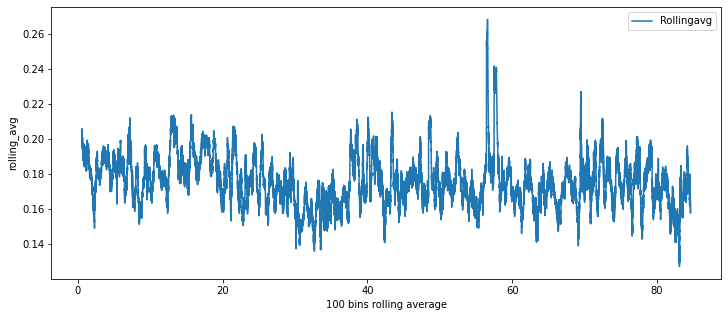

In [116]:

# set figure size
plt.figure( figsize = ( 12, 5))
  
df_ml = df_ml.sort_values(by="datenew", ascending = True)
# plot a simple time series plot
df_ml['rolling_avg' ] = df_ml.polarity_textblob.rolling(1000).mean()
  
# plot using rolling average
sns.lineplot(x = 'datenew',
             y = 'rolling_avg',
             data = df_ml,
             label = 'Rollingavg')
  
plt.xlabel('1000 bins rolling average')
  

Text(0.5, 0, ' bins rolling average')

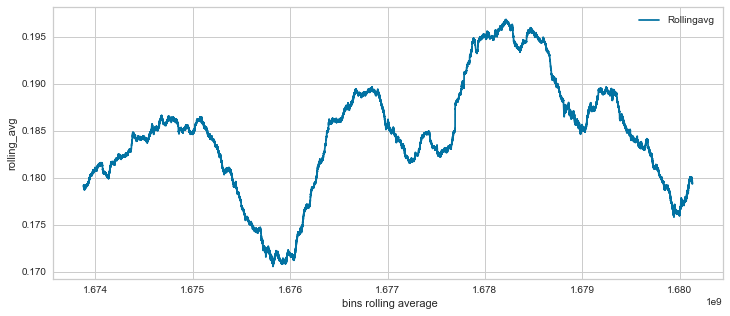

In [291]:

# set figure size
plt.figure( figsize = ( 12, 5))
  
df = df.sort_values(by="datenew", ascending = True)
# plot a simple time series plot
df['rolling_avg' ] = df.polarity.rolling(35079).mean()
  
# plot using rolling average
sns.lineplot(x = 'datenew',
             y = 'rolling_avg',
             data = df,
             label = 'Rollingavg')
  
plt.xlabel('35079 bins rolling average')
  

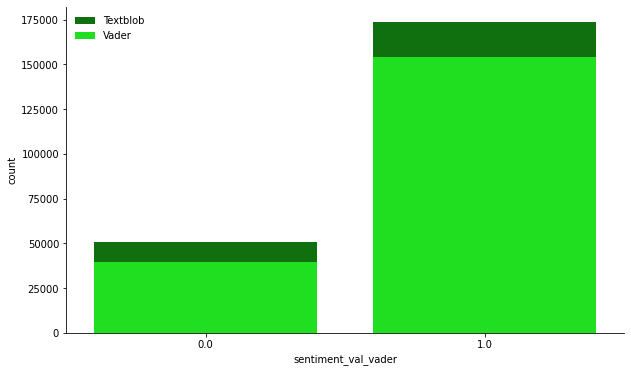

In [128]:
ax = plt.subplots()
ax = sns.countplot(df_ml['sentiment_val_textblob'], color = 'green', label = 'Textblob')
ax = sns.countplot(df_ml['sentiment_val_vader'], color = 'lime',label = 'Vader')
ax.legend(frameon=False)
ax = sns.despine()
plt.show()
#Vader is more cautious in assigining positive and negative sentiments

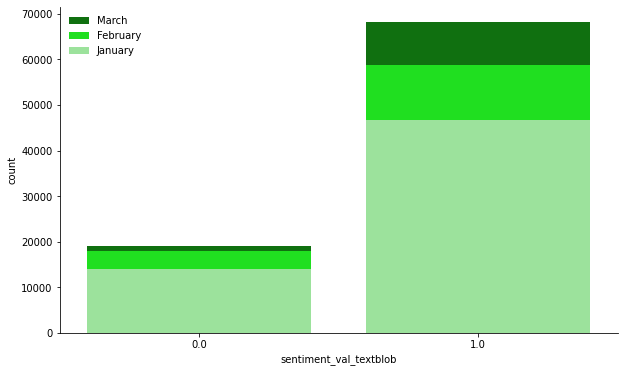

In [121]:


ax = plt.subplots()
ax = sns.countplot(df_ml[df['date']>'2023-03-01']['sentiment_val_textblob'],color = 'green', label = 'March')
ax = sns.countplot(df_ml[df_ml['date'].between('2023-02-01','2023-03-01',inclusive = True)]['sentiment_val_textblob'], color = 'lime',label = 'February')
ax = sns.countplot(df_ml[df_ml['date'].between('2023-01-01','2023-02-01',inclusive = True)]['sentiment_val_textblob'], color = 'lightgreen',label = 'January')
ax.legend(frameon=False)
ax = sns.despine()
plt.show()


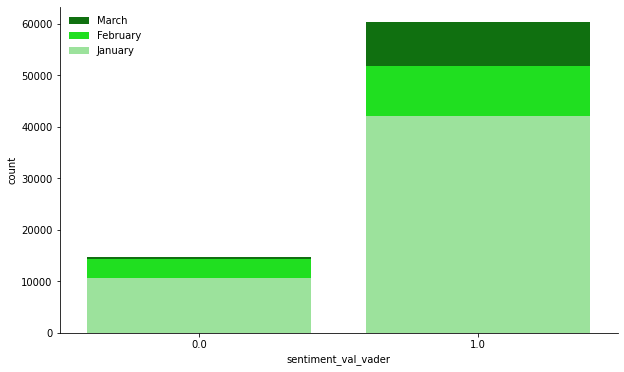

In [122]:

ax = plt.subplots()
ax = sns.countplot(df_ml[df['date']>'2023-03-01']['sentiment_val_vader'],color = 'green', label = 'March')
ax = sns.countplot(df_ml[df_ml['date'].between('2023-02-01','2023-03-01',inclusive = True)]['sentiment_val_vader'], color = 'lime',label = 'February')
ax = sns.countplot(df_ml[df_ml['date'].between('2023-01-01','2023-02-01',inclusive = True)]['sentiment_val_vader'], color = 'lightgreen',label = 'January')
ax.legend(frameon=False)
ax = sns.despine()
plt.show()


In [130]:
df_ml.polarity_textblob.describe().T

count   224514.000
mean         0.176
std          0.322
min         -1.000
25%          0.033
50%          0.200
75%          0.375
max          1.000
Name: polarity_textblob, dtype: float64

In [132]:
df_ml.columns

Index(['date', 'content', 'content_adj', 'polarity_textblob',
       'sentiment_val_textblob', 'sentiment_val_vader', 'datenew',
       'rolling_avg'],
      dtype='object')

In [134]:
drop_columns = ['date','polarity_textblob','datenew','rolling_avg']

df_ml.drop(drop_columns, axis = 1, inplace = True)

In [135]:
df_ml.columns

Index(['content', 'content_adj', 'sentiment_val_textblob',
       'sentiment_val_vader'],
      dtype='object')

In [136]:
df_ml.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 224514 entries, 500035 to 0
Data columns (total 4 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   content                 224514 non-null  object 
 1   content_adj             224514 non-null  object 
 2   sentiment_val_textblob  224514 non-null  float64
 3   sentiment_val_vader     194300 non-null  float64
dtypes: float64(2), object(2)
memory usage: 18.6+ MB


In [138]:
df_ml = df_ml.dropna()
missing_values(df_ml)

,Missing_Number,Missing_Percent


In [139]:
df_ml["content"].str.isspace().sum()  #Check if any text is all whitespace or not

0

In [140]:
# TEXT MINING INVOLVING THREE MAIN STEPS:

# TOKENISATION (SPLITTING A PHRASE IN WORDS and converting to lower case):
# This step is one of the top priorities when it comes to working on text mining. Tokenization is essentially splitting a phrase, sentence, paragraph, or an entire text document into smaller units, such as individual words or terms. Each of these smaller units are called tokens.


# NOISE REMOVAL (REMOVING UNNECESSARY WORDS/CHARACTERS LIKE COMMA, A, THE AN, etc. ):
# Any piece of text which is not relevant to the context of the data and the end-output can be specified as the noise. For example – language stopwords (commonly used words of a language – is, am, the, of, in etc), URLs or links, upper and lower case differentiation, punctuations and industry specific words. This step deals with removal of all types of noisy entities present in the text.


# LEXICON NORMALISATION ( IDENTIFYING THE BASE WORDS FROM MULTIPLE WAYS OF WRITING THE SAME WORD):
# Lexicon Normalization: Another type of textual noise is about the multiple representations exhibited by single word. For example – “play”, “player”, “played”, “plays” and “playing” are the different variations of the word – “play”. Though they mean different things, contextually they all are similar. This step converts all the disparities of a word into their normalized form (also known as lemma). There are two methods of lexicon normalisation; Stemming or Lemmatization. Lemmatization is recommended for this case, because Lemmatization as this will return the root form of each word (rather than just stripping suffixes, which is stemming)
# LEMMATIZATION: identifying the base word
# STEMMING: removal of suffixes



In [141]:
df_ml.head()

,content,content_adj,sentiment_val_textblob,sentiment_val_vader
500035,I used chat gpt to get gym workout program and it was so good. Sore af rn!,gpt gym good af,1.000,1.000
500032,#ChatGPT \n\nSo much #Censorship.\n\nNever trust a system you don't admin. https://t.co/nlcr0FUeDx,much,1.000,0.000
500031,@GoogleAI #LAMDA Versus @OpenAI #ChatGPT ?! Who cares? Lamda isn't available. ChatGPT is. What's my reason to be interested in comparing the two? Lamda is fiction! There's no good evidence it exis...,lamda available interested lamda good,1.000,1.000
500030,It’s not what you say\n(or write)\n\nIt’s how you say it\n(or write it)\n\nLong live the competitive (*human) advantage of a non transactional sales outreach in this new age of assisted tech\n\n*T...,live competitive human transactional new prospect situational,1.000,1.000
500029,"@LoftedLearning Great thread thanks Logan. I’ve used chat GPT , but in a limited way, and this has given me so many more ideas.",great thread many,1.000,1.000


In [142]:
# # COLLECT WORDS:

positive_words = " ".join(df_ml[df_ml["sentiment_val_textblob"] == 1].content_adj).split()

In [163]:

negative_words = " ".join(df_ml[df_ml["sentiment_val_textblob"] == 0].content_adj).split()

In [145]:
review_text = df_ml["content_adj"]
all_words = " ".join(review_text)

In [147]:
wordcloud = WordCloud(width = 800, height = 400, background_color = 'black', max_words = 250).generate(all_words)

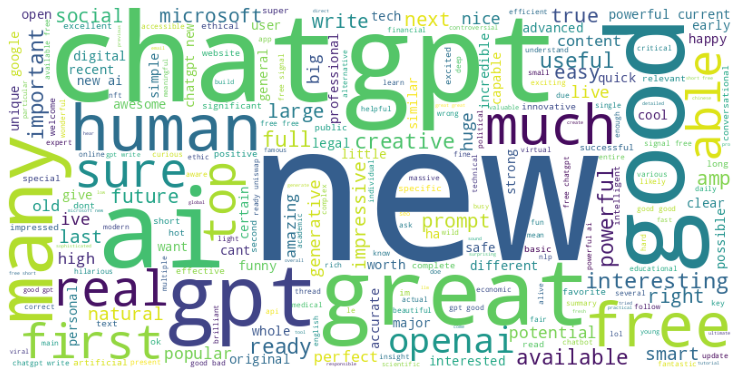

<Figure size 720x432 with 0 Axes>

In [153]:
plt.figure(figsize=(13,13))
plt.imshow(wordcloud)
plt.axis("off")
plt.show()
plt.savefig('ChatGPT-WordCloud-byTasha.jpg',dpi=300)

In [149]:
positive_words = " ".join(positive_words)

In [154]:
wordcloud = WordCloud(width = 800, height = 400, background_color = 'white', max_words = 250).generate(positive_words)

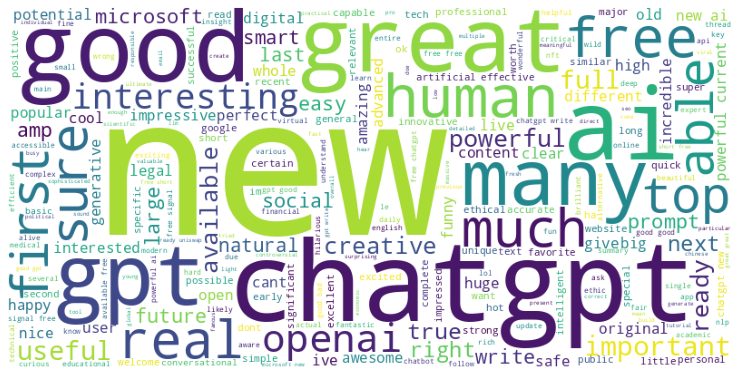

<Figure size 720x432 with 0 Axes>

In [155]:

plt.figure(figsize=(13,13))
plt.imshow(wordcloud)
plt.axis("off")
plt.show()
plt.savefig('ChatGPT-WordCloud-positive-byTasha.jpg',dpi=300)

In [164]:
negative_words = " ".join(negative_words)

In [165]:
wordcloud = WordCloud(width = 800, height = 400, background_color = 'white', max_words = 250).generate(negative_words)

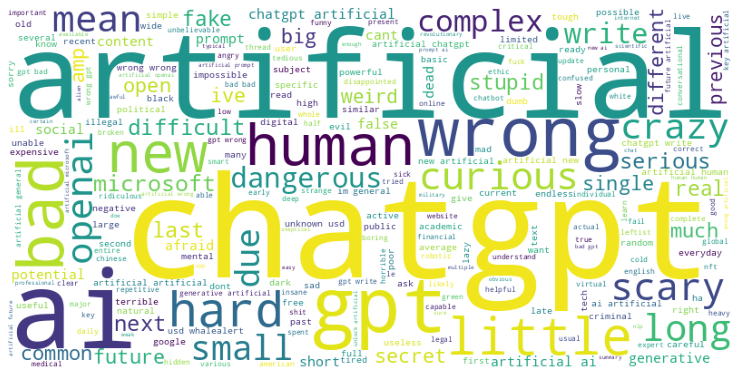

In [166]:
plt.figure(figsize=(13,13))
plt.imshow(wordcloud)
plt.axis("off")
plt.savefig('ChatGPT-WordCloud-negative-byTasha.jpg',dpi=300)

In [ ]:
# counter_all = Counter(word_tokenize(all_words))
# counter_all.most_common(50)

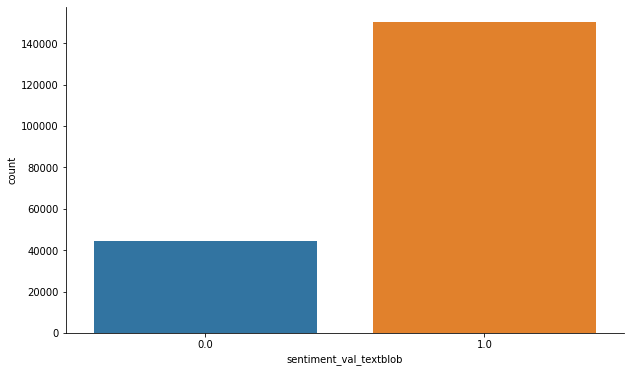

In [167]:
sns.countplot(df_ml['sentiment_val_textblob'])
sns.despine()

In [172]:
# Cleaning content column as well, to put it to train data

def tokenize_clean(data):
    data = data.replace("'","").lower()
    # Remove username from tweets (words that start with @)
    data = re.sub('@[\w]+','',data)
    #print(data)
    # Separate sentences from each tweet, and use POS for individual sentences:
    tokenized=nltk.sent_tokenize(data)
    text_joined = []
    for i in tokenized:
        # Tokenize each word
        text_tokens = word_tokenize(i)
        # Remove punctuations
        tokens_without_punc = [w for w in text_tokens if w.isalpha()]
        # Remove stop words
        tokens_without_sw = [t for t in tokens_without_punc if t not in stop_words]
        # Lemmatize: Get base words only
        tokens_cleaned = [WordNetLemmatizer().lemmatize(t) for t in tokens_without_sw]
        # Attaching words together
        text_tokens = " ".join(tokens_cleaned)
        text_joined.append(text_tokens)
    text_joined = " ".join(text_joined)
    #print(text_joined)
    return text_joined


df_ml["content_cleaned"] = df_ml["content"].apply(tokenize_clean)


In [174]:
df_ml["content_cleaned"].shape

(194300,)

In [175]:
# SPLIT DATASET, and interchanging 0 and 1 : 0: positive and 1 is negative

X = df_ml["content_cleaned"].values
y = df_ml["sentiment_val_textblob"].map({0:1, 1:0}).values


In [176]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, stratify = y, random_state = 101)

# stratify is used to avoid any biases to creep into the split of test and train set. So we have all proportions of both data set, y is used as an axis as we need to be unbiased in y i.e. recommend



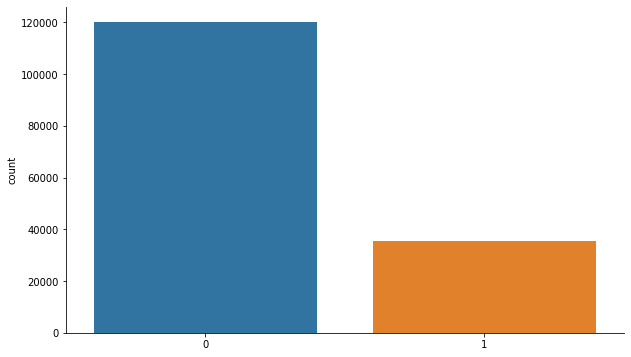

In [177]:
sns.countplot(y_train)
sns.despine()

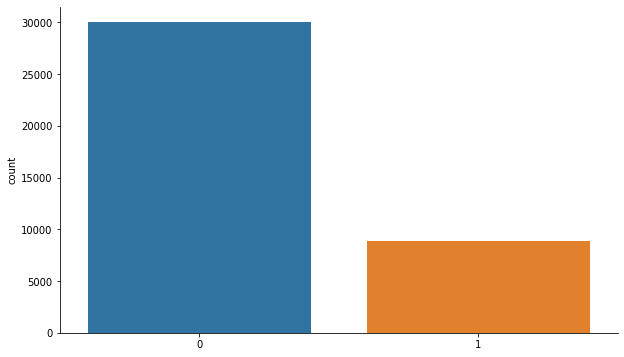

In [178]:
sns.countplot(y_test)
sns.despine()

In [179]:
# COUNT VECTORISATION : only gives the frequency of each word in the row, like number of times 'awesome' comes in a review
from sklearn.feature_extraction.text import CountVectorizer
vectorizer = CountVectorizer()
X_train_count = vectorizer.fit_transform(X_train)
X_test_count = vectorizer.transform(X_test)



In [180]:
# MODELLING WITH ML MODELS

from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score, f1_score, recall_score, precision_score, average_precision_score

In [181]:
def eval(model, X_train, X_test):
  y_pred = model.predict(X_test)
  y_pred_train = model.predict(X_train)
  print("Test_SET")
  cm = confusion_matrix(y_test, y_pred)
  print(cm)
  print(classification_report(y_test,y_pred))
  print("Train_SET")
  print(classification_report(y_train, y_pred_train))
  disp = ConfusionMatrixDisplay(confusion_matrix=cm)
  disp.plot()
  plt.show()
  #plot_confusion_matrix(model, X_test, y_test, cmap="plasma")

In [182]:
# LOGISTIC REGRESSION with COUNTVECTOR DATA

from sklearn.linear_model import LogisticRegression

logreg_count = LogisticRegression(C=0.1, max_iter = 1000, class_weight= 'balanced', random_state =101)

logreg_count.fit(X_train_count, y_train)

LogisticRegression(C=0.1, class_weight='balanced', max_iter=1000,
                   random_state=101)

Logistic Regression Model
---------------------------
Test_SET
[[28583  1434]
 [  522  8321]]
              precision    recall  f1-score   support

           0       0.98      0.95      0.97     30017
           1       0.85      0.94      0.89      8843

    accuracy                           0.95     38860
   macro avg       0.92      0.95      0.93     38860
weighted avg       0.95      0.95      0.95     38860

Train_SET
              precision    recall  f1-score   support

           0       0.99      0.96      0.97    120069
           1       0.86      0.97      0.91     35371

    accuracy                           0.96    155440
   macro avg       0.93      0.96      0.94    155440
weighted avg       0.96      0.96      0.96    155440



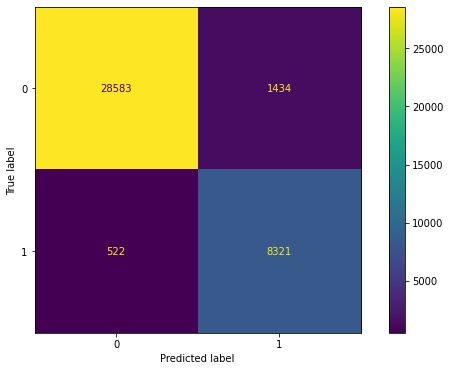

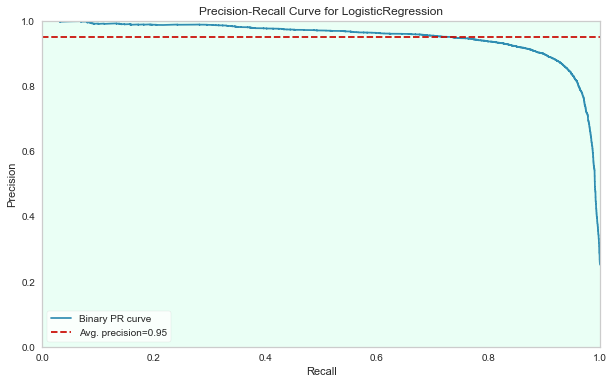

LogReg_Count_rec :  [0.95222707 0.94097026]
LogReg_Count_f1  :  [0.96691587 0.8948274 ]
LogReg_Count_AP (avg. precision from precision recall curve)  :  0.9489633848297918


In [183]:
print("Logistic Regression Model")

print("---------------------------")

eval(logreg_count,X_train_count,X_test_count)
import random
import pylab as pl
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import auc


# To draw a precision-recall curve

from yellowbrick.classifier import PrecisionRecallCurve

viz = PrecisionRecallCurve(LogisticRegression(C = 0.1, max_iter = 1000, class_weight = "balanced"), classes = logreg_count.classes_, per_class = True, cmap = "Set1")

# ! NOTE ! THIS PRECISIONRECALL FUNCTION ONLY WORKED WHEN I INTERCHANGED THE LABEL OF THE CLASSES using MAP WHEN ASSIGNING X AND Y!!
fig, ax = plt.subplots(figsize = (10, 6))
ax.set_facecolor('#eafff5')

viz.fit(X_train_count,y_train)
viz.score(X_test_count, y_test)
viz.show();

y_pred = logreg_count.predict(X_test_count)
# SINCE average is None, scores output are for both the 0: recommended and 1: not recommended class
log_count_rec = recall_score(y_test, y_pred, pos_label = 0, average = None)
log_count_f1 = f1_score(y_test, y_pred, pos_label = 0, average = None)
log_AP = viz.score_


#print("viz.score_       : ", viz.score_)
print("LogReg_Count_rec : ", log_count_rec)
print("LogReg_Count_f1  : ", log_count_f1)
print("LogReg_Count_AP (avg. precision from precision recall curve)  : ", log_AP)


In [184]:
# CROSS VALIDATION

from sklearn.metrics import make_scorer
from sklearn.model_selection import cross_val_score

# EVALUATES AND PUT LABELS ON DIFFERENT SCORES LIKE ACCURACY. AND PRECISION, RECALL, F1 SCORE FOR BOTH CLASSES 0 AND 1

custom_scorer = {'accuracy': make_scorer(accuracy_score), 'precision-0': make_scorer(precision_score, pos_label = 0),
                 'recall-0': make_scorer(recall_score, pos_label = 0),
                 'f1-0': make_scorer(f1_score, pos_label = 0)
#                  'precision-1': make_scorer(precision_score, pos_label = 1),
#                  'recall-1': make_scorer(recall_score, pos_label = 1),
#                  'f1-1': make_scorer(f1_score, pos_label = 1)
                 }


for i, j in custom_scorer.items():
  # i is the key label, j is the action/command of that key item
  # instantiate logreg model
  model = LogisticRegression(C=0.1, max_iter = 1000, class_weight = "balanced", random_state = 101)
  # crossvalscore will output multiple accuracies (or whichever parameter we specify for the model, considering different random selections of test and train data sets)
  # Mean of the scores given by cross val:
  scores = cross_val_score(estimator = model, X = X_train_count, y = y_train, cv = 10, scoring= j).mean()
  # saving recall and f1 of class 0 : recommend
  if i == "recall-0":
    log_count_rec = scores
  elif i == "f1-0":
    log_count_f1 = scores
  # print all the scores
  print(f" {i:20} score for LogReg_Count : {scores}\n")



 accuracy             score for LogReg_Count : 0.9471242923314463

 precision-0          score for LogReg_Count : 0.9818315289394723

 recall-0             score for LogReg_Count : 0.9491125900917841

 f1-0                 score for LogReg_Count : 0.9651932290389451



NBMulti_Count Model
-------------------
Test_SET
[[28738  1279]
 [ 3171  5672]]
              precision    recall  f1-score   support

           0       0.90      0.96      0.93     30017
           1       0.82      0.64      0.72      8843

    accuracy                           0.89     38860
   macro avg       0.86      0.80      0.82     38860
weighted avg       0.88      0.89      0.88     38860

Train_SET
              precision    recall  f1-score   support

           0       0.93      0.96      0.95    120069
           1       0.86      0.75      0.80     35371

    accuracy                           0.92    155440
   macro avg       0.89      0.86      0.87    155440
weighted avg       0.91      0.92      0.91    155440



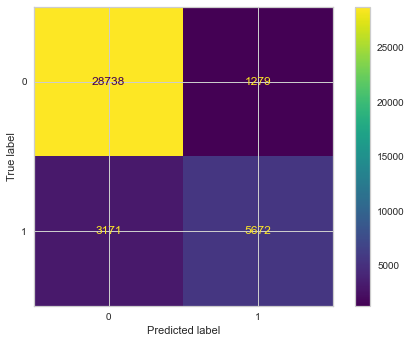

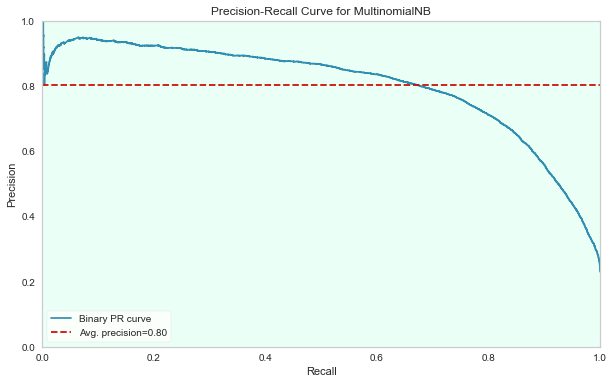

nbmulti_Count_rec :  [0.95739081 0.64141129]
nbmulti_Count_f1  :  [0.92814004 0.71824744]
nbmulti_Count_AP (avg. precision from precision recall curve)  :  0.8032005799601265


In [185]:
print("NBMulti_Count Model")
print("-------------------")
# NAIVE BAYES MODEL:

from sklearn.naive_bayes import MultinomialNB
nbmulti_count = MultinomialNB()
nbmulti_count.fit(X_train_count, y_train)

eval(nbmulti_count, X_train_count, X_test_count)

import random
import pylab as pl
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import auc


# To draw a precision-recall curve

from yellowbrick.classifier import PrecisionRecallCurve

viz = PrecisionRecallCurve(MultinomialNB(), classes = nbmulti_count.classes_, per_class = True, cmap = "Set1")

# ! NOTE ! THIS PRECISIONRECALL FUNCTION ONLY WORKED WHEN I INTERCHANGED THE LABEL OF THE CLASSES using MAP WHEN ASSIGNING X AND Y!!
fig, ax = plt.subplots(figsize = (10, 6))
ax.set_facecolor('#eafff5')

viz.fit(X_train_count,y_train)
viz.score(X_test_count, y_test)
viz.show();

y_pred = nbmulti_count.predict(X_test_count)
# SINCE average is None, scores output are for both the 0: recommended and 1: not recommended class
nbmulti_count_rec = recall_score(y_test, y_pred, pos_label = 0, average = None)
nbmulti_count_f1 = f1_score(y_test, y_pred, pos_label = 0, average = None)
nbmulti_AP = viz.score_


#print("viz.score_       : ", viz.score_)
print("nbmulti_Count_rec : ", nbmulti_count_rec)
print("nbmulti_Count_f1  : ", nbmulti_count_f1)
print("nbmulti_Count_AP (avg. precision from precision recall curve)  : ", nbmulti_AP)



In [186]:
# CROSS VALIDATION

from sklearn.metrics import make_scorer
from sklearn.model_selection import cross_val_score

# EVALUATES AND PUT LABELS ON DIFFERENT SCORES LIKE ACCURACY. AND PRECISION, RECALL, F1 SCORE FOR BOTH CLASSES 0 AND 1

custom_scorer = {'accuracy': make_scorer(accuracy_score), 'precision-0': make_scorer(precision_score, pos_label = 0),
                 'recall-0': make_scorer(recall_score, pos_label = 0),
                 'f1-0': make_scorer(f1_score, pos_label = 0)
#                  'precision-1': make_scorer(precision_score, pos_label = 1),
#                  'recall-1': make_scorer(recall_score, pos_label = 1),
#                  'f1-1': make_scorer(f1_score, pos_label = 1)
                 }


for i, j in custom_scorer.items():
  # i is the key label, j is the action/command of that key item
  # instantiate nbmulti model
  model = MultinomialNB()
  # crossvalscore will output multiple accuracies (or whichever parameter we specify for the model, considering different random selections of test and train data sets)
  # Mean of the scores given by cross val:
  scores = cross_val_score(estimator = model, X = X_train_count, y = y_train, cv = 10, scoring= j).mean()
  # saving recall and f1 of class 0 : recommend
  if i == "recall-0":
    nbmulti_count_rec = scores
  elif i == "f1-0":
    nbmulti_count_f1 = scores
  # print all the scores
  print(f" {i:20} score for nbmulti_Count : {scores}\n")


 accuracy             score for nbmulti_Count : 0.8754117344312917

 precision-0          score for nbmulti_Count : 0.9047146317700433

 recall-0             score for nbmulti_Count : 0.9374442806913359

 f1-0                 score for nbmulti_Count : 0.920787543217853



SVM Count Model
-------------------
Test_SET
[[28569  1448]
 [  498  8345]]
              precision    recall  f1-score   support

           0       0.98      0.95      0.97     30017
           1       0.85      0.94      0.90      8843

    accuracy                           0.95     38860
   macro avg       0.92      0.95      0.93     38860
weighted avg       0.95      0.95      0.95     38860

Train_SET
              precision    recall  f1-score   support

           0       0.99      0.95      0.97    120069
           1       0.86      0.97      0.91     35371

    accuracy                           0.96    155440
   macro avg       0.93      0.96      0.94    155440
weighted avg       0.96      0.96      0.96    155440



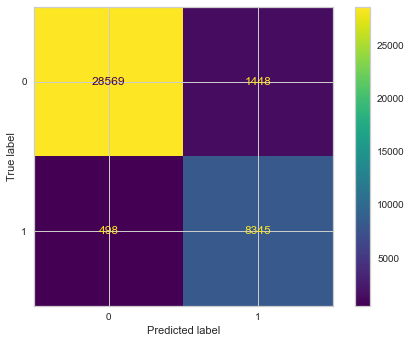

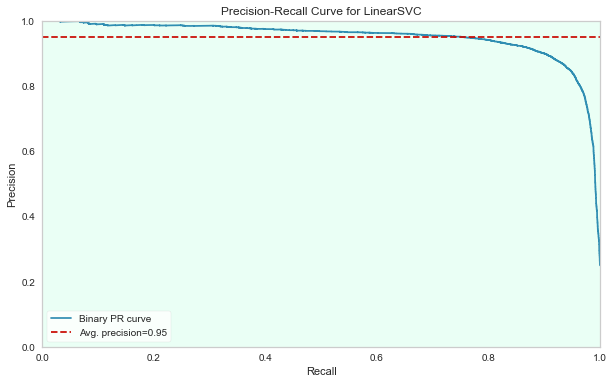

svc_Count_rec :  [0.95176067 0.94368427]
svc_Count_f1  :  [0.96706384 0.89557845]
svc_Count_AP (avg. precision from precision recall curve)  :  0.9492617811506565


In [187]:
# SUPPORT VECTOR MACHINE (SVM)

print("SVM Count Model")
print("-------------------")
# SVM MODEL:

from sklearn.svm import LinearSVC
svc_count = LinearSVC(C = 0.01, class_weight = "balanced", random_state = 101)
svc_count.fit(X_train_count, y_train)

eval(svc_count, X_train_count, X_test_count)

import random
import pylab as pl
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import auc


# To draw a precision-recall curve

from yellowbrick.classifier import PrecisionRecallCurve

viz = PrecisionRecallCurve(LinearSVC(C = 0.01, class_weight = "balanced", random_state = 101), classes = svc_count.classes_, per_class = True, cmap = "Set1")

# ! NOTE ! THIS PRECISIONRECALL FUNCTION ONLY WORKED WHEN I INTERCHANGED THE LABEL OF THE CLASSES using MAP WHEN ASSIGNING X AND Y!!
fig, ax = plt.subplots(figsize = (10, 6))
ax.set_facecolor('#eafff5')

viz.fit(X_train_count,y_train)
viz.score(X_test_count, y_test)
viz.show();

y_pred = svc_count.predict(X_test_count)
# SINCE average is None, scores output are for both the 0: recommended and 1: not recommended class
svc_count_rec = recall_score(y_test, y_pred, pos_label = 0, average = None)
svc_count_f1 = f1_score(y_test, y_pred, pos_label = 0, average = None)
svc_count_AP = viz.score_


#print("viz.score_       : ", viz.score_)
print("svc_Count_rec : ", svc_count_rec)
print("svc_Count_f1  : ", svc_count_f1)
print("svc_Count_AP (avg. precision from precision recall curve)  : ", svc_count_AP)








In [189]:
# CROSS VALIDATION

from sklearn.metrics import make_scorer
from sklearn.model_selection import cross_val_score

# EVALUATES AND PUT LABELS ON DIFFERENT SCORES LIKE ACCURACY. AND PRECISION, RECALL, F1 SCORE FOR BOTH CLASSES 0 AND 1

custom_scorer = {'accuracy': make_scorer(accuracy_score), 'precision-0': make_scorer(precision_score, pos_label = 0),
                 'recall-0': make_scorer(recall_score, pos_label = 0),
                 'f1-0': make_scorer(f1_score, pos_label = 0)
#                  'precision-1': make_scorer(precision_score, pos_label = 1),
#                  'recall-1': make_scorer(recall_score, pos_label = 1),
#                  'f1-1': make_scorer(f1_score, pos_label = 1)
                 }


for i, j in custom_scorer.items():
  # i is the key label, j is the action/command of that key item
  # instantiate svc model
  model = LinearSVC(C = 0.01, class_weight = "balanced", random_state = 101)
  # crossvalscore will output multiple accuracies (or whichever parameter we specify for the model, considering different random selections of test and train data sets)
  # Mean of the scores given by cross val:
  scores = cross_val_score(estimator = model, X = X_train_count, y = y_train, cv = 10, scoring= j).mean()
  # saving recall and f1 of class 0 : recommend
  if i == "recall-0":
    svc_count_rec = scores
  elif i == "f1-0":
    svc_count_f1 = scores
  # print all the scores
  print(f" {i:20} score for svc_Count : {scores}\n")

 accuracy             score for svc_Count : 0.9474202264539372

 precision-0          score for svc_Count : 0.9825782965135904

 recall-0             score for svc_Count : 0.9487544628895955

 f1-0                 score for svc_Count : 0.9653682851466646



RF_Count Model
--------------
Test_SET
[[26971  3046]
 [ 1228  7615]]
              precision    recall  f1-score   support

           0       0.96      0.90      0.93     30017
           1       0.71      0.86      0.78      8843

    accuracy                           0.89     38860
   macro avg       0.84      0.88      0.85     38860
weighted avg       0.90      0.89      0.89     38860

Train_SET
              precision    recall  f1-score   support

           0       0.96      0.90      0.93    120069
           1       0.73      0.88      0.80     35371

    accuracy                           0.90    155440
   macro avg       0.85      0.89      0.87    155440
weighted avg       0.91      0.90      0.90    155440



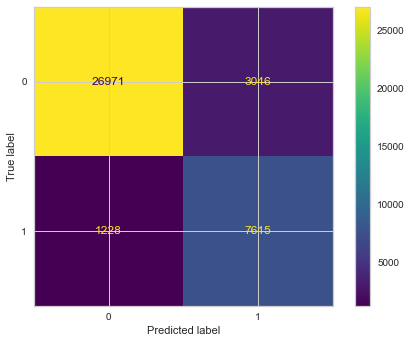

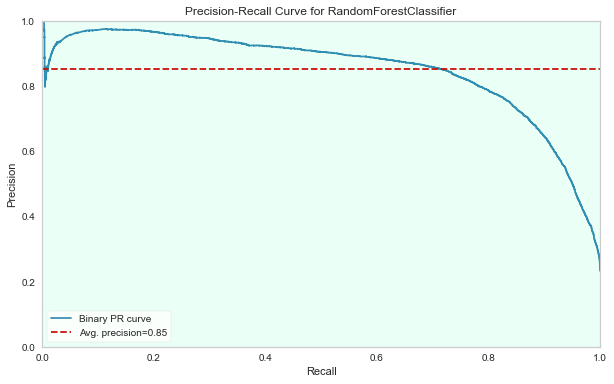

rf_Count_rec :  [0.89852417 0.8611331 ]
rf_Count_f1  :  [0.92658376 0.78086546]
rf_Count_AP (avg. precision from precision recall curve)  :  0.8521549935072738


In [190]:
# RANDOM FOREST WITH COUNT VECTORIZER


from sklearn.ensemble import RandomForestClassifier

rf_count = RandomForestClassifier(n_estimators = 200, max_depth = 11, class_weight = "balanced", random_state = 101, n_jobs = -1)
rf_count.fit(X_train_count, y_train)

print("RF_Count Model")
print("--------------")
eval(rf_count, X_train_count, X_test_count)

import random
import pylab as pl
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import auc


# To draw a precision-recall curve

from yellowbrick.classifier import PrecisionRecallCurve

viz = PrecisionRecallCurve(RandomForestClassifier(n_estimators = 200, max_depth = 11, class_weight = "balanced", random_state = 101, n_jobs = -1), classes = rf_count.classes_, per_class = True, cmap = "Set1")

# ! NOTE ! THIS PRECISIONRECALL FUNCTION ONLY WORKED WHEN I INTERCHANGED THE LABEL OF THE CLASSES using MAP WHEN ASSIGNING X AND Y!!
fig, ax = plt.subplots(figsize = (10, 6))
ax.set_facecolor('#eafff5')

viz.fit(X_train_count,y_train)
viz.score(X_test_count, y_test)
viz.show();

y_pred = rf_count.predict(X_test_count)
# SINCE average is None, scores output are for both the 0: recommended and 1: not recommended class
rf_count_rec = recall_score(y_test, y_pred, pos_label = 0, average = None)
rf_count_f1 = f1_score(y_test, y_pred, pos_label = 0, average = None)
rf_count_AP = viz.score_


#print("viz.score_       : ", viz.score_)
print("rf_Count_rec : ", rf_count_rec)
print("rf_Count_f1  : ", rf_count_f1)
print("rf_Count_AP (avg. precision from precision recall curve)  : ", rf_count_AP)




In [191]:
# CROSS VALIDATION

from sklearn.metrics import make_scorer
from sklearn.model_selection import cross_val_score

# EVALUATES AND PUT LABELS ON DIFFERENT SCORES LIKE ACCURACY. AND PRECISION, RECALL, F1 SCORE FOR BOTH CLASSES 0 AND 1

custom_scorer = {'accuracy': make_scorer(accuracy_score), 'precision-0': make_scorer(precision_score, pos_label = 0),
                 'recall-0': make_scorer(recall_score, pos_label = 0),
                 'f1-0': make_scorer(f1_score, pos_label = 0)
#                  'precision-1': make_scorer(precision_score, pos_label = 1),
#                  'recall-1': make_scorer(recall_score, pos_label = 1),
#                  'f1-1': make_scorer(f1_score, pos_label = 1)
                 }


for i, j in custom_scorer.items():
  # i is the key label, j is the action/command of that key item
  # instantiate rf model
  model = RandomForestClassifier(n_estimators = 200, max_depth = 12, class_weight = "balanced", random_state = 101, n_jobs = -1)
  # crossvalscore will output multiple accuracies (or whichever parameter we specify for the model, considering different random selections of test and train data sets)
  # Mean of the scores given by cross val:
  scores = cross_val_score(estimator = model, X = X_train_count, y = y_train, cv = 10, scoring= j).mean()
  # saving recall and f1 of class 0 : recommend
  if i == "recall-0":
    rf_count_rec = scores
  elif i == "f1-0":
    rf_count_f1 = scores
  # print all the scores
  print(f" {i:20} score for rf_Count : {scores}\n")

 accuracy             score for rf_Count : 0.8961657231085949

 precision-0          score for rf_Count : 0.9576045943052586

 recall-0             score for rf_Count : 0.9058123675454409

 f1-0                 score for rf_Count : 0.9308548205930837



In [192]:
# COMPARE MODELS


compare = pd.DataFrame({"Model":["NaiveBayes(Multi)_Count", "LogReg_Count", "SVM_Count",
                                  "Random Forest_Count" ],
                        "F1_Score": [nbmulti_count_f1,log_count_f1,svc_count_f1,rf_count_f1],
                        "Recall_Score": [nbmulti_count_rec,log_count_rec,svc_count_rec,rf_count_rec],
                        "Average_Precision_Score": [nbmulti_AP,log_AP,svc_count_AP,rf_count_AP]})


compare = compare.sort_values(by="Recall_Score", ascending = True)

fig = px.bar(compare, x = "Recall_Score", y = "Model", title = "Recall_Score")

fig.show()


compare = compare.sort_values(by="F1_Score", ascending = True)

fig = px.bar(compare, x = "F1_Score", y = "Model", title = "F1_Score")

fig.show()


compare = compare.sort_values(by="Average_Precision_Score", ascending = True)

fig = px.bar(compare, x = "Average_Precision_Score", y = "Model", title = "Average_Precision_Score")

fig.show()


In [215]:
#For f1 score- log reg performed way better than others, for recall and average precision both SVM and Log reg were comparable.


#Now I do some predictive analysis using logreg model:

# PREDICTION


review1 = "Chatgpt is great!"
review2 = "Chatgpt is terrible."
rev_list = [review1,review2]
tok = [tokenize_clean(r) for r in rev_list]
tok_count = vectorizer.transform(tok)
model_pred_check = svc_count


for ind, t in enumerate(tok_count):
    if model_pred_check.predict(t) == [0]:
        print(rev_list[ind]," is a Positive Tweet")

    else:
        print(rev_list[ind], " is a Negative Tweet")


Chatgpt is great!  is a Positive Tweet
Chatgpt is terrible.  is a Negative Tweet


In [216]:
print(max(compare['Average_Precision_Score']))

0.9492617811506565


In [217]:
compare['mean'] = compare.mean(axis=1)

In [218]:
compare = compare.sort_values(by="mean", ascending = False)

In [219]:
# SVM and Logistical Regression model prove to be the best here.
# Overall accuracy of the model improved from 0.88 to 0.93 when negation stopwords are not removed from the data.

In [220]:
compare

,Model,F1_Score,Recall_Score,Average_Precision_Score,mean
2,SVM_Count,0.965,0.949,0.949,0.954
1,LogReg_Count,0.965,0.949,0.949,0.954
3,Random Forest_Count,0.931,0.906,0.852,0.896
0,NaiveBayes(Multi)_Count,0.921,0.937,0.803,0.887


In [221]:
y_pred = logreg_count.predict(X_test_count)
y_pred

array([0, 0, 0, ..., 1, 1, 0])

In [222]:
y_test

array([0, 0, 0, ..., 1, 1, 0])

No handles with labels found to put in legend.


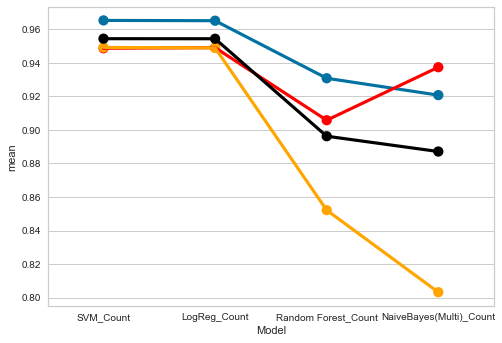

In [223]:
sns.pointplot(x='Model', y = 'F1_Score', data= compare)
sns.pointplot(x='Model', y = 'Recall_Score', data= compare, color = 'red')
sns.pointplot(x='Model', y = 'Average_Precision_Score', data= compare, color = 'orange')
sns.pointplot(x='Model', y = 'mean', data= compare,color = 'black')
plt.legend()